# Imports

In [1]:
import scanpy as sc

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.style as style
import matplotlib

import plotly.figure_factory as ff
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

# utils function -- helper functions for plotting
import sys
sys.path.append('../../utils/')
import figure_utils as figure_utils

In [2]:
# create figures directory
import os

directory_path = 'figures'
if not os.path.exists(directory_path):
    # If not, create the directory
    os.makedirs(directory_path)
    print(f"Directory '{directory_path}' created successfully.")
else:
    print(f"Directory '{directory_path}' already exists.")

Directory 'figures' already exists.


# Plot aesthetics

In [3]:
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 500 # 150 dpi resolution
matplotlib.rcParams['image.cmap'] = 'Spectral_r' # preferred color map
# matplotlib.rcParams['figure.figsize'] = [6, 6] # Square
# no bounding boxes or axis:
matplotlib.rcParams['axes.spines.bottom'] = "off"
matplotlib.rcParams['axes.spines.top'] = "off"
matplotlib.rcParams['axes.spines.left'] = "off"
matplotlib.rcParams['axes.spines.right'] = "off"

In [4]:
# UMAP PARAMS
DOT_SIZE = 25
LEGEND_FONTSIZE = 8
LEGEND_FONTOUTLINE = 1
UMAP_FIGSIZE = (10,10)

# SEXES COLOR -- NEW
HERM_COLOR = '#ff8b00'
MALE_COLOR = '#2258a5'
SHARED_SEX_COLOR = '#349c55'

# AXIS TICK COLORS
AXIS_TICK_COLORS = 'black'

# lighter teal -- EQ
SHEATH_COLOR = '#3ac9c9' # '#369e9e'
SOCKET_COLOR = '#c47841'

# COMPARTMENTS COLOR -- Non-neural, Coelomocyte, Glia, Neuron
COMPARTMENTS_COLOR = ['#c63287','#ff99da','#693996','#fdcd0f']

# Load Data

In [5]:
# load data
ad_url = "https://fh-pi-setty-m-eco-public.s3.us-west-2.amazonaws.com/worm-glia-atlas/WholeData.h5ad" 
ad_glia_url = "https://fh-pi-setty-m-eco-public.s3.us-west-2.amazonaws.com/worm-glia-atlas/GliaOnly.h5ad" 

adata = sc.read('../../data/WholeData.h5ad', backup_url=ad_url)
adata_glia = sc.read('../../data/GliaOnly.h5ad', backup_url=ad_glia_url)

In [6]:
# adata_glia2.uns['FiguresData_Sheath_Selection_Results'].keys()

In [7]:
# adata_glia.uns['FiguresData_Sheath_Selection_Results']['Minimal_Set_Results']

In [8]:
# del adata_glia2.uns['FiguresData_Sheath_Selection_Results']['Minimal_Set_Results']

In [9]:
# adata_glia2.uns['FiguresData_Sheath_Selection_Results']['Minimal_Set_Results'] = adata_glia.uns['FiguresData_Sheath_Selection_Results']['Minimal_Set_Results'].copy()

In [10]:
# adata_glia.uns['sex_specificity_colors'] = [SHARED_SEX_COLOR, HERM_COLOR, MALE_COLOR]

In [11]:
# df = pd.read_csv('SHSO_Probabilities.csv', index_col=0)
# adata_glia.uns['SheathSocket_Probability_Estimates'] = df.iloc[:,:4].copy()
# adata_glia.uns['SheathSocket_Probability_Estimates'].head()

In [12]:
# save the anndata right now
# adata_glia.write('../../data/GliaOnly.h5ad')

In [13]:
# subset the data for Sheat/Socket Minimal Set -- the following clusters were not included
EXCLUDE_CLUSTERS = ['30', '17', '18', '29', '20','13','14']

# data for the shso selection
adata_shso = sc.read('../../data/GliaOnly.h5ad')

# add the sheath and socket probabilities from the uns keys
add_df = pd.concat([adata_shso.obs.copy(), adata_shso.uns['SheathSocket_Probability_Estimates'].copy()], axis=1).copy()
del adata_shso.obs
adata_shso.obs = add_df.copy()

In [14]:
# create data used for the ShSo Markers selection
adata_sub = adata_shso[~adata_shso.obs['leiden_postBC'].isin(EXCLUDE_CLUSTERS),:]
adata_sub_male = adata_sub[(adata_sub.obs['sex'] == 'Male') & (adata_sub.obs['sex_specificity'].isin(['Both','Male'])),:]
adata_sub_herm = adata_sub[(adata_sub.obs['sex'] == 'Hermaphrodite') & (adata_sub.obs['sex_specificity'].isin(['Both','Herm'])),:]

In [15]:
# add the probability estimates summary
# adata_glia.uns['FiguresData_Sheath_Selection_Results']['Minimal_Set_Results']

# SFig 5A -- Sheath/Socket Markers Dataset

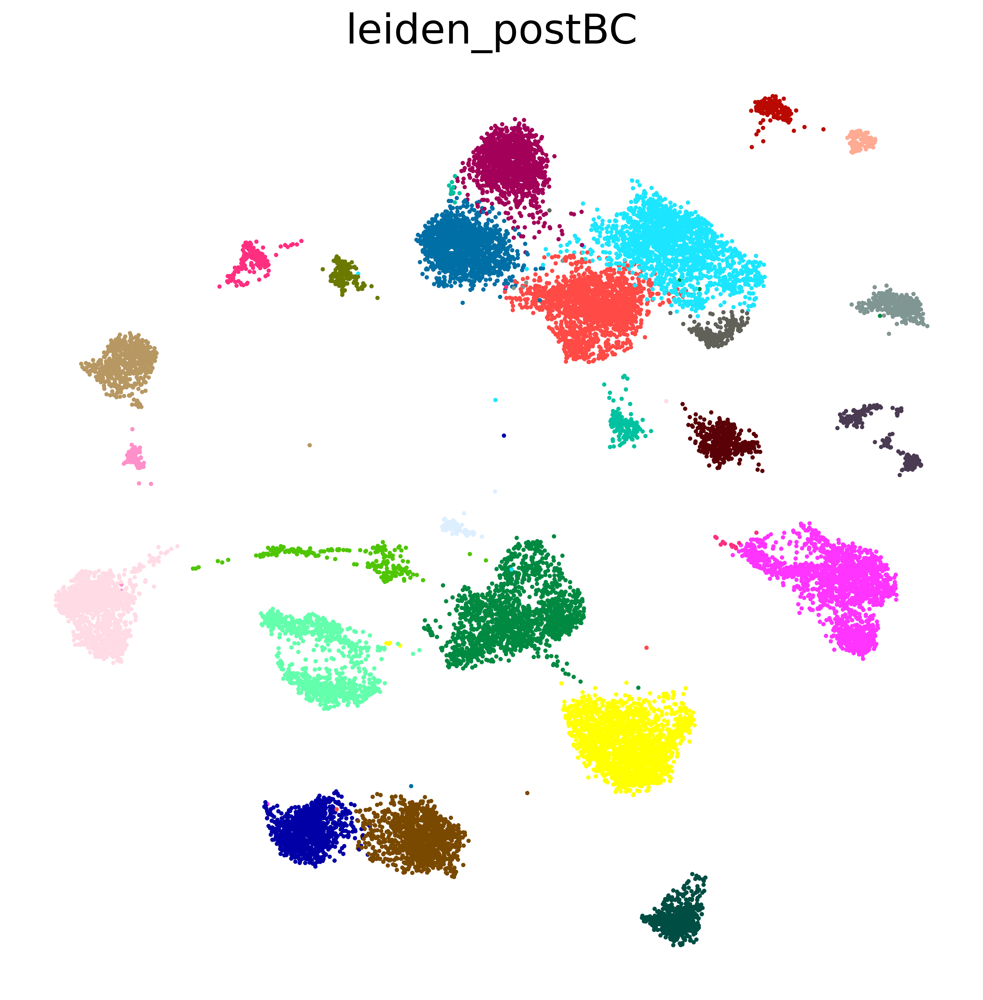

In [16]:
# all data
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20}):
    sc.pl.umap(
        adata_sub,
        color=['leiden_postBC'],
        frameon=False,
        size=DOT_SIZE,
        ncols=4,
        legend_loc=None,
        na_color='#f2f0f0',
        save='S5A_glial_clusters_used.png'
    )

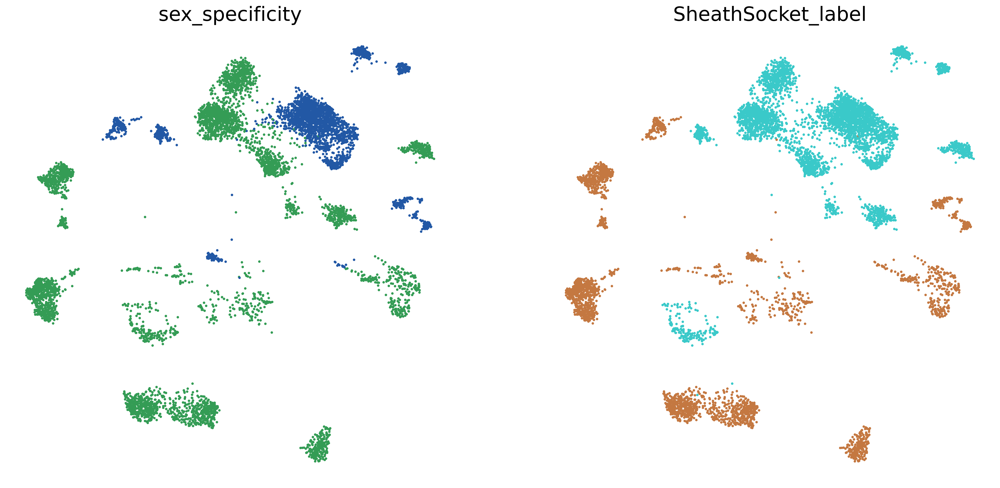

In [17]:
# Male data
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20}):
    sc.pl.umap(
        adata_sub_male,
        color=['sex_specificity','SheathSocket_label'],
        frameon=False,
        size=DOT_SIZE + 10,
        ncols=4,
        legend_loc=None,
        na_color='#f2f0f0',
        save=f'S5A_Male_Data_SHSO.png',
    )

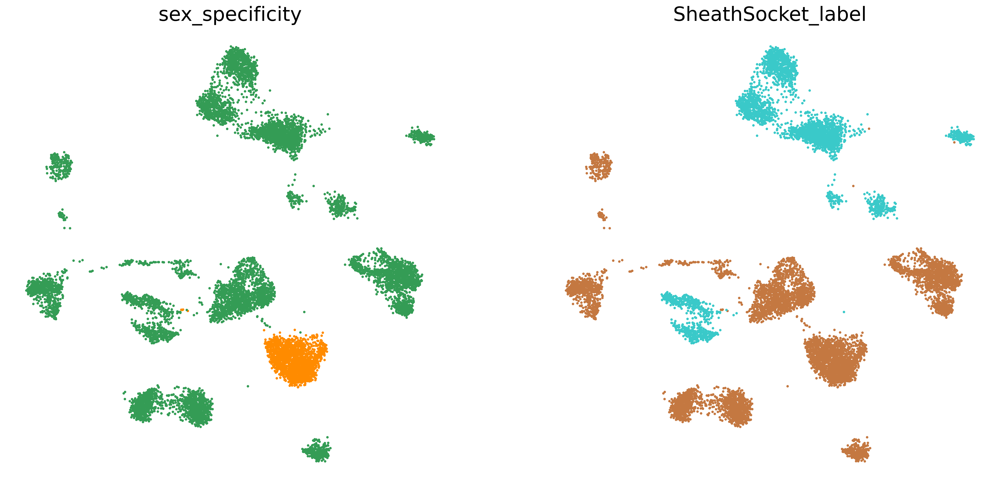

In [18]:
# Herm data
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20}):
    sc.pl.umap(
        adata_sub_herm,
        color=['sex_specificity','SheathSocket_label'],
        frameon=False,
        size=DOT_SIZE + 10,
        ncols=4,
        legend_loc=None,
        na_color='#f2f0f0',
        save=f'S5A_Herm_Data_SHSO.png',
    )

# SFig 5B -- Sheath & Socket Baseline Probability Estimates

In [19]:
# Male data -- Sheath and Socket baseline probabilities
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20}):
    sc.pl.umap(
        adata_sub_male.copy(),
        color=['SheathSocket_label','baseline_Sheath_probabilities','baseline_Socket_probabilities'],
        frameon=False,
        size=DOT_SIZE + 10,
        ncols=3,
        save=f'S5B_Male_Data_SHSO_Probabilities.png',
        vmax=1,
        vmin=0,
        return_fig=True,
        legend_loc=None
    )

In [20]:
# Herm data -- Sheath and Socket baseline probabilities
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size':20}):
    sc.pl.umap(
        adata_sub_herm,
        color=['SheathSocket_label','baseline_Sheath_probabilities','baseline_Socket_probabilities'],
        frameon=False,
        size=DOT_SIZE + 10,
        ncols=3,
        save=f'S5B_Herm_Data_SHSO_Probabilities.png',
        vmax=1,
        vmin=0,
        legend_loc=None
    )

# SFig 5C -- Sheath & Socket Identified Genes - Gene Expression

In [21]:
# # identified socket markers expression
# with matplotlib.pyplot.rc_context({'figure.figsize':(10,10),'font.size':20.0}):
#     # socket
#     sc.pl.umap(
#         adata_glia,
#         color=adata_glia.uns['FiguresData_Socket_Selection_Results']['Identified_Genes'],
#         size=DOT_SIZE,
#         frameon=False,
#         ncols=5,
#         layer='magic_imputed_postBC',
#         save='S5C_identified_socket_markers.png'
#     )

In [22]:
# # identified socket markers expression
# with matplotlib.pyplot.rc_context({'figure.figsize':(10,10),'font.size':20.0}):
#     # sheath
#     sc.pl.umap(
#         adata_glia,
#         color=adata_glia.uns['FiguresData_Sheath_Selection_Results']['Identified_Genes'],
#         size=DOT_SIZE,
#         frameon=False,
#         ncols=5,
#         layer='magic_imputed_postBC',
#         save='S5C_identified_sheath_markers.png'
#     )

# SFig 5D -- Minimal Set Summaries - Probability Estimates Per Cluster, Sheath & Socket

In [23]:
# get sheath and socket probability estimates
sheath_minset_summary = adata_glia.uns['FiguresData_Sheath_Selection_Results']['Minimal_Set_Results']
socket_minset_summary = adata_glia.uns['FiguresData_Socket_Selection_Results']['Minimal_Set_Results']

In [24]:
# plotting function
def add_scatter_trace(fig, df, label, y_offset):
    df_label = df[df['min_set_label'] == label]
    fig.add_trace(go.Scatter(
        # x=y_offset + np.random.rand(len(df_label)) * 0.4,  # Adding jitter to x-values
        x = y_offset + np.random.uniform(low=-0.5, high=0.5, size=len(df_label)) * 0.45, # much better implementation of jitter
        y=df_label['mean_probability_estimates'],  # Y-values are the mean_probability_estimates
        mode='markers',
        marker=dict(
            size=9,
            symbol='diamond',
            color=df_label['sex_color'],
            opacity=0.6,
        ),
        name=label,
        text=df_label['cluster'],
    ))

In [25]:
# sheath - combo on sheath clusters
fig = go.Figure()

# ordering -- each element in this list is a unique element in the minset
# summary dataframe
unique_labels = ['fullset','10_genes'] + [f'{i}_genes' for i in range(1,10)]

# N = len(minimalset_results)
y_offsets = np.arange(len(sheath_minset_summary.min_set_label.unique()))

for label, y_offset in zip(unique_labels, y_offsets):
    add_scatter_trace(fig, sheath_minset_summary, label, y_offset)

fig.update_layout( 
    coloraxis_showscale=False, 
    plot_bgcolor='rgba(0,0,0,0)',
    width=1200,
    height=600, title='<b>Gene Combinations</b> -- Sheath Probability Estimates',
    font=dict(family='Arial', size=20),
    showlegend=False

)
fig.update_traces(marker_showscale=False)
fig.update_yaxes(title='mean probability estimates', range=[0,1.1])  # Update y-axis title & set the range
fig.update_xaxes(title='combinations', tickvals=y_offsets, ticktext=unique_labels, tickangle=90)
fig.write_image(file='figures/SheathCombos_ProbestSummary.svg')
fig.write_html(file='figures/SheathCombos_ProbestSummary.html')
fig.show()

In [26]:
# socket - combo on socket clusters
fig = go.Figure()

# ordering -- each element in this list is a unique element in the minset
# summary dataframe
unique_labels = ['fullset','10_genes'] + [f'{i}_genes' for i in range(1,10)]

# N = len(minimalset_results)
y_offsets = np.arange(len(socket_minset_summary.min_set_label.unique()))

for label, y_offset in zip(unique_labels, y_offsets):
    add_scatter_trace(fig, socket_minset_summary, label, y_offset)

fig.update_layout( 
    coloraxis_showscale=False, 
    plot_bgcolor='rgba(0,0,0,0)',
    width=1200,
    height=600, title='<b>Gene Combinations</b> -- Socket Probability Estimates',
    font=dict(family='Arial', size=20),
    showlegend=False

)
fig.update_traces(marker_showscale=False)
fig.update_yaxes(title='mean probability estimates', range=[0,1.1])  # Update y-axis title & set the range
fig.update_xaxes(title='combinations', tickvals=y_offsets, ticktext=unique_labels, tickangle=90)
fig.write_image(file='figures/SocketCombos_ProbestSummary.svg')
fig.write_html(file='figures/SocketCombos_ProbestSummary.html')
fig.show()

# SFig 5E -- <i>F20A1.1</i> Expression

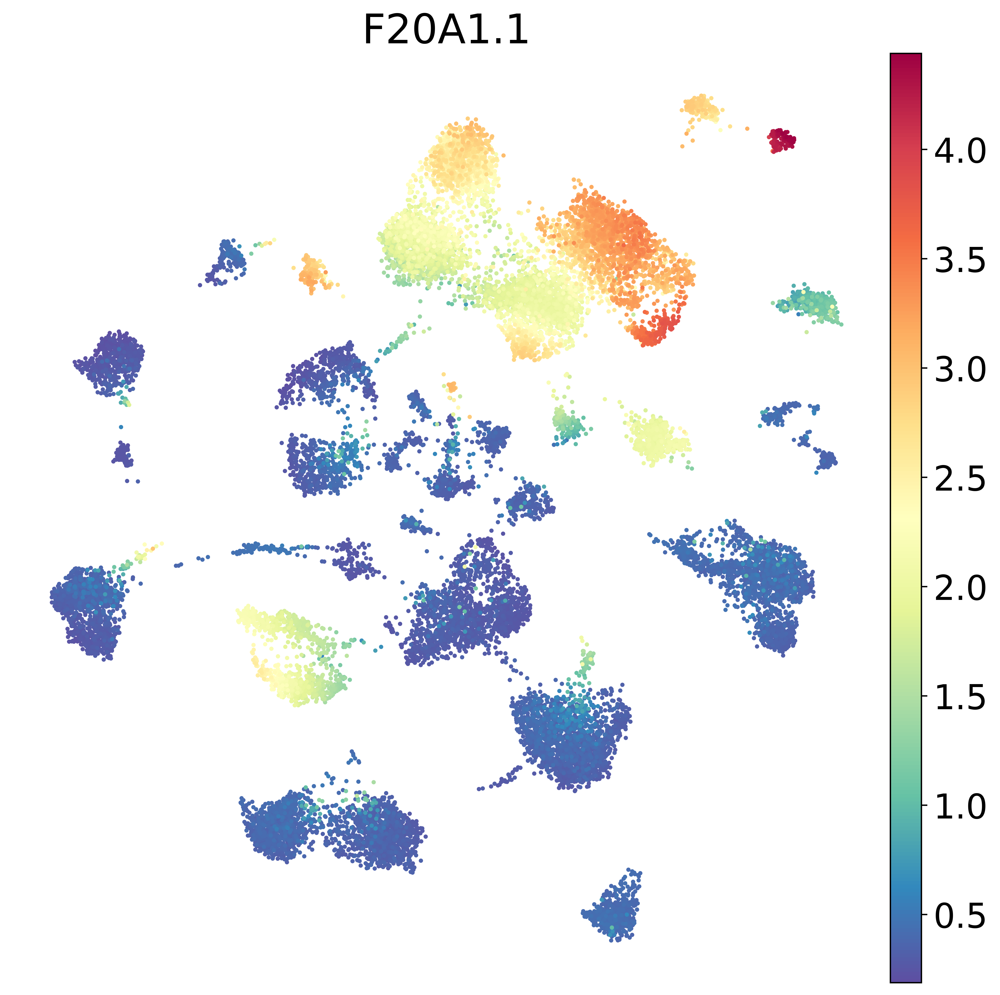

In [27]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['F20A1.1'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S5E_{gene}.png',
            layer='magic_imputed_postBC',
        )

# SFig 5F -- <i>zipt-2.2</i> Expression

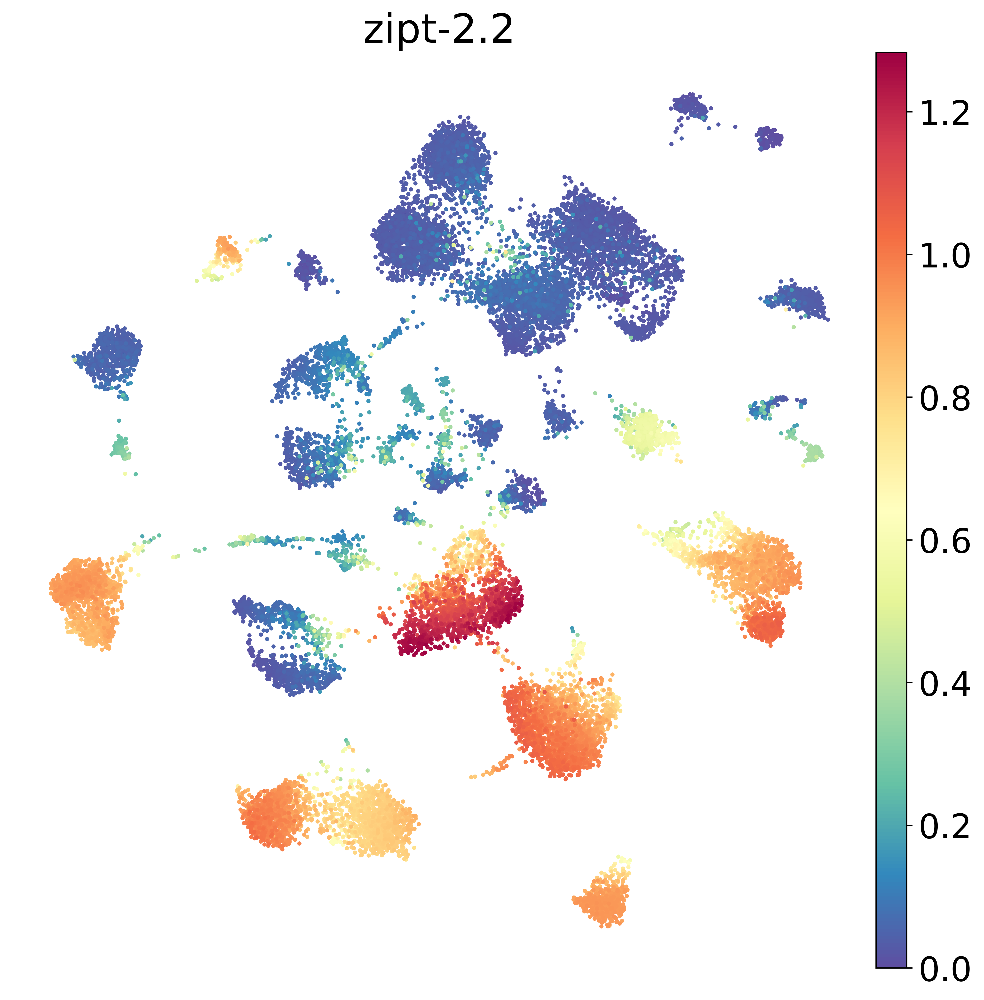

In [28]:
with matplotlib.pyplot.rc_context({'figure.figsize':UMAP_FIGSIZE, 'font.size': 20.0}):
    PLOT_GENES = ['zipt-2.2'] 
    for gene in PLOT_GENES:
        sc.pl.umap(
            adata_glia,
            color=[gene],
            frameon=False,
            size=DOT_SIZE,
            save=f'figure_S5F_{gene}.png',
            layer='magic_imputed_postBC',
        )

# SFig 5I -- Sheath & Socket Feature Selection/Ranking with L2

In [29]:
# set matplotlib style -- ggplot
style.use('ggplot')

# config for scanpy -- for the L2 ordering gene ranking results
sc.settings.verbosity = 0
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.1 numpy==1.21.0 scipy==1.7.0 pandas==1.3.0 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 pynndescent==0.5.4


In [30]:
# df_l2 = pd.read_csv('SHSO_L2_GeneRanking_Ordering.csv', index_col=0)

In [31]:
# add it to adata_glia
# adata_glia.uns['SheathSocket_L2_GeneRanking_Order'] = df_l2.index.tolist()

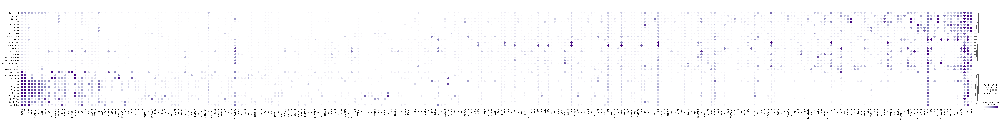

In [32]:
# L2 ordering 
l2_ordered_genes = adata_glia.uns['SheathSocket_L2_GeneRanking_Order']

# dotplot
with matplotlib.pyplot.rc_context({'figure.figsize':(20,5)}):
    ax = sc.pl.dotplot(adata_glia, var_names=l2_ordered_genes, use_raw=False, groupby='Cluster_Celltype', dendrogram=True, cmap='Purples', vmin=0, vmax=2, return_fig=True)
    ax.dot_edge_lw = 0.01
    ax.get_axes()['mainplot_ax'].axes.tick_params(axis='both', which='both', length=0)
    plt.savefig('figures/S5A_dotplot_L2_ranking.png', dpi=300, bbox_inches='tight')    

# SFig 5L -- Heirarchical Clustering of Glia, Neurons & Non-neural cells

In [33]:
# # update the labels
# adata.obs.loc[:,'Cluster_Celltype'] = adata.obs.loc[:,'Cluster_Celltype'].str.replace('23 - skin-like glia','23 - Seam cells')
# adata.obs.loc[:,'Cluster_Celltype'] = adata.obs.loc[:,'Cluster_Celltype'].str.replace('23 - Posterior hyp','16 - Posterior hyp')

# adata.obs['Cluster_Celltype'] = adata.obs['Cluster_Celltype'].astype('category')

In [34]:
# convert cluster numbers
sheath_clusters = ['26','8','9', '33', '36', '1', '10', '22', '14', '41', '45'] # glia hierarchical cluster identified
socket_clusters = ['25','29','17','18','20','13','6','39','27','43','40','46','30','50','28','31','4','2','35','5'] # glia hierarchical cluster identified

# define a function to convert the cluster cell type column -- will be used with apply function
def assign_shso(cols):
    leiden, cluster_celltype = cols
    if leiden in sheath_clusters:
        return f'{leiden} - Sheath'
    elif leiden in socket_clusters:
        return f'{leiden} - Socket'
    else:
        return cluster_celltype

# update 
adata.obs.loc[:,'Cluster_Celltype'] = adata.obs.loc[:,['leiden_preBC','Cluster_Celltype']].apply(assign_shso, axis=1)
adata.obs['Cluster_Celltype'] = adata.obs['Cluster_Celltype'].astype('category')

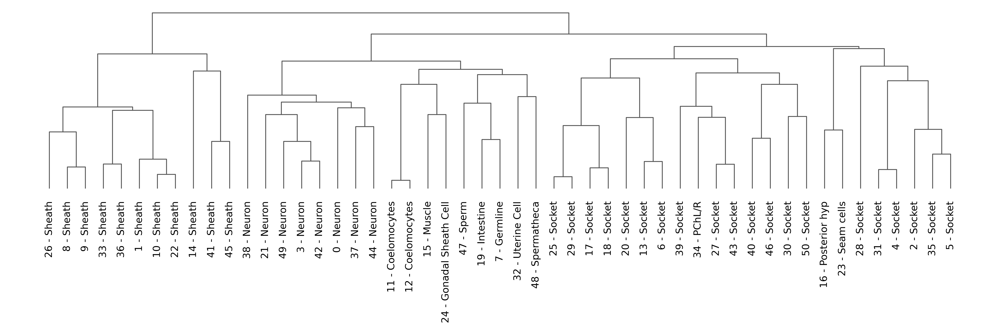

In [35]:
sc.tl.dendrogram(adata, groupby='Cluster_Celltype', use_raw=False, use_rep='X_pca')
with matplotlib.pyplot.rc_context({'figure.figsize':(30,6),'font.size':20}):
    sc.pl.dendrogram(adata, groupby='Cluster_Celltype', save='S5L_HierarchicalClustering_WholeData.png')

In [36]:
# save the adata
# adata_glia.write('../../data/GliaOnly-copy2.h5ad')